# Models
I trained several U-net models with different setups. Each model has encoding layers and decoding layers. Models were trained on Google Cloud Service VMs equiped with either a single K80 or P100 GPU.<br>
- [u_net.py](https://github.com/dezmoanded/Kaggle-Carvana-Image-Masking-Challenge/blob/master/model/u_net.py)

### Encoding layer:
1. Conv2d 3x3
2. BatchNorm
3. Relu
4. Conv2d 3x3
5. BatchNorm
6. Relu
7. MaxPool2d 2x2

### Center layer:
1. Conv2D 3x3
2. BatchNorm
3. Relu
4. Conv2d 3x3
5. BatchNorm
6. Relu

### Decoding layer:
1. UpSample2D 2x2
2. (concat with output from final Relu of matching encoding layer, num channels doubled)
3. Conv2d 3x3
4. BatchNorm
5. Relu
6. Conv2d 3x3
7. BatchNorm
8. Relu
9. Conv2d 3x3
10. BatchNorm
11. Relu

Finally, apply a Conv2d 1x1 resulting in a one channel output which is the same height and width as the input.

### The following table shows the number of channels for each layer of each model:

Model|Encoding|Center|Decoding
-|-|-|-
A|64, 128, 256, 512|1024|512, 256, 128, 64
B|16, 32, 64, 128, 512, 1024|2048|1024, 512, 128, 64, 32, 16
C|8, 16, 32, 64, 128, 512|1024|512, 128, 64, 32, 16, 8
D|32, 32, 32, 64, 128, 512|1024|512, 128, 64, 32, 32, 32
E|8, 16, 32, 64, 128, 512|1024|512, 128, 64, 32, 16, 8
G|8, 16, 32, 64, 128, 512|1024|512, 128, 64, 32, 16, 8

### Results per model
For this competion, the public LB score represents 25% of the test data and the private LB score represents the remaining 75%

Model|Input size|Batch size|Dice score|Private LB Dice score|Info
-|-|-|-|-
A|128x128|16|.990||80/20 validation split
B|1024x1024|2|.994||80/20 split,<br>double number of channels for all layers
C|1024x1024|6|.9958||90/10 validation split
D|1024x1024|5|0.996291|0.995773|First 3 layers -> 32 channels
E|1024x1024|7|0.995323|0.995035|
G|1920x1280|4|0.996805|0.996589|Original image size with 1px padding<br>on each side (no resize)
Ensemble|1918x1280|12|0.996806|0.996600|

# Ensemble
- [ensemble_model.py](https://github.com/dezmoanded/Kaggle-Carvana-Image-Masking-Challenge/blob/master/ensemble/ensemble_model.py)

For my ensemble method, I used a single layer:
1. Conv2d 3x3
2. BatchNorm
3. Relu

Then a 1x1 Conv2D to give the final prediction.

### Input
For the input of the ensemble, I took the 3 color channels from the image and then added the predictions from models C, D, E and G. This resulted in an input with 3 + 4 = 7 channels

### Steps
1. Gather predictions on train+validation data for each model. 
    - [predict_train_data.py](https://github.com/dezmoanded/Kaggle-Carvana-Image-Masking-Challenge/blob/master/ensemble/predict_train_data.py)
2. Train ensemble model.
    - [train_ensemble.py](https://github.com/dezmoanded/Kaggle-Carvana-Image-Masking-Challenge/blob/master/ensemble/train_ensemble.py)
3. Make predictions for each model on test data.
    - [predict_test_data.py](https://github.com/dezmoanded/Kaggle-Carvana-Image-Masking-Challenge/blob/master/ensemble/predict_test_data.py)
4. Use ensemble to predict test data.
    - [ensemble_predict.py](https://github.com/dezmoanded/Kaggle-Carvana-Image-Masking-Challenge/blob/master/ensemble/ensemble_predict.py)

# Conclusion
My ensemble method was succesful, with a lot of room for improvement.
On the public LB, my ensemble scored only 1e-6 over the dice score of my best model, however, on the private LB my ensemble was able to succesfully generalize and scored 1e-5 better than my best model.

I'm confident my ensemble would have produced a larger improvement if I had trained more quality models similar to G.

# Examples

In [27]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from params import orig_height, orig_width
import cv2
import matplotlib
from model.losses import dice_coeff
matplotlib.rcParams['figure.figsize'] = [20,20]

In [41]:
df_train = pd.read_csv('input/train_masks.csv')
ids_train = df_train['img'].map(lambda s: s.split('.')[0])

model_names = ["A", "C", "D", "E", "G", "Ensemble"]
models = {model: pd.read_csv("submit/submission{}.csv.gz".format(model)) for model in model_names}

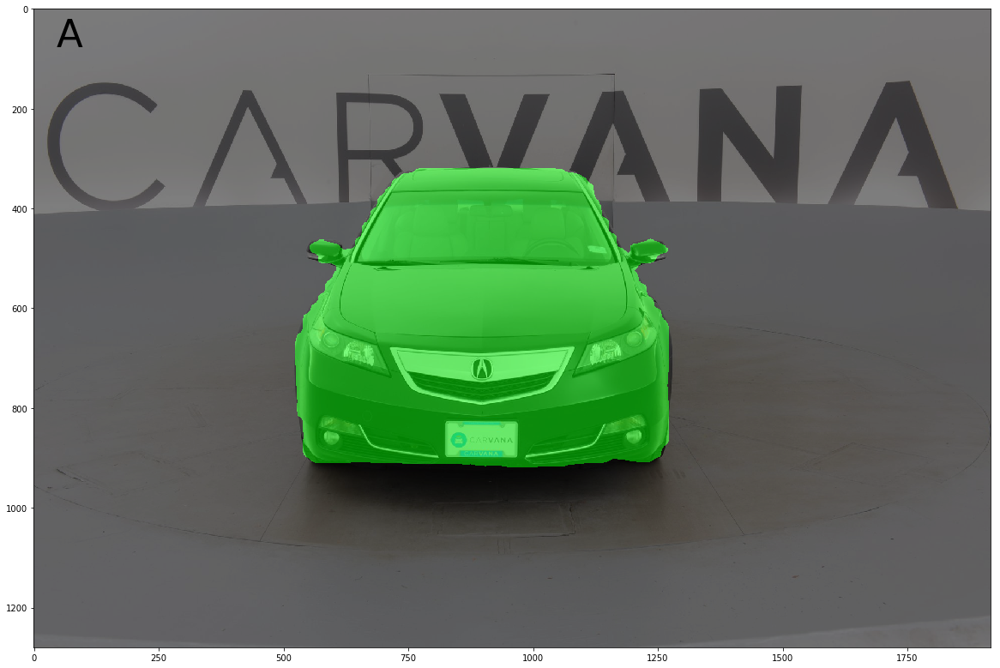

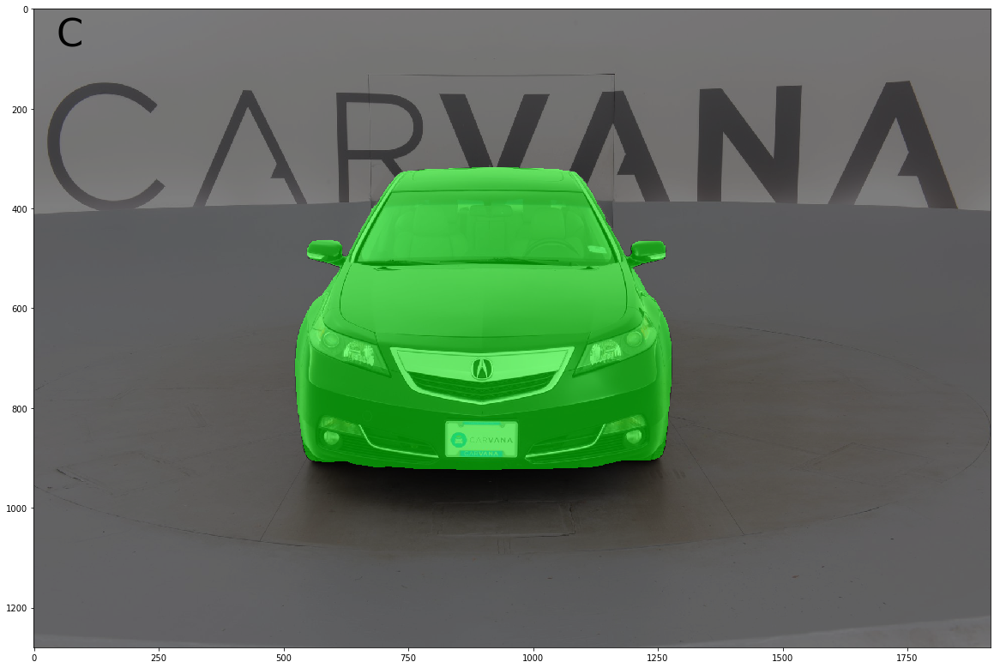

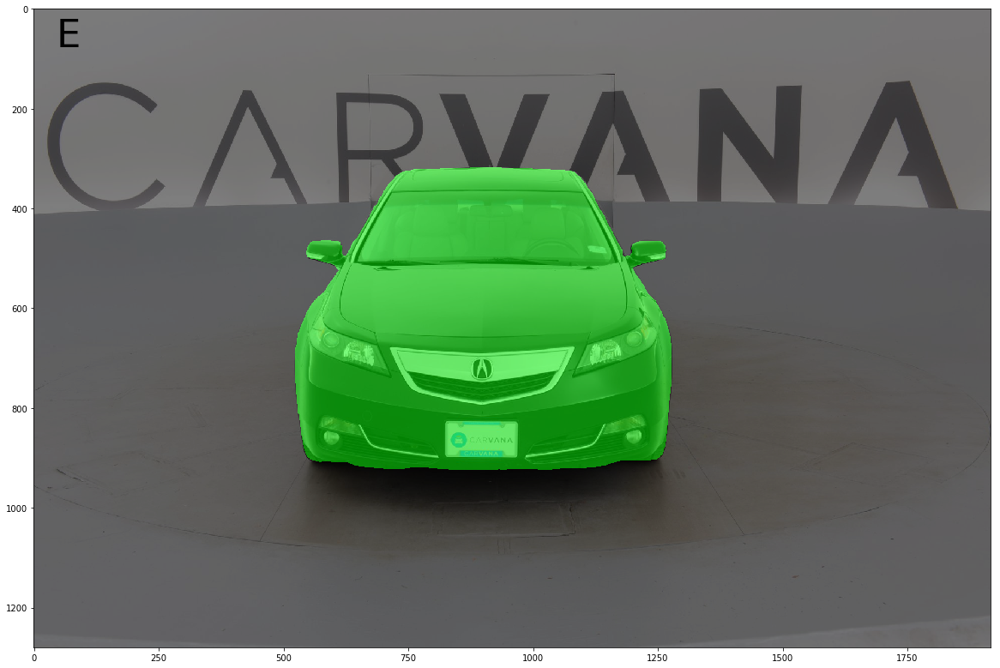

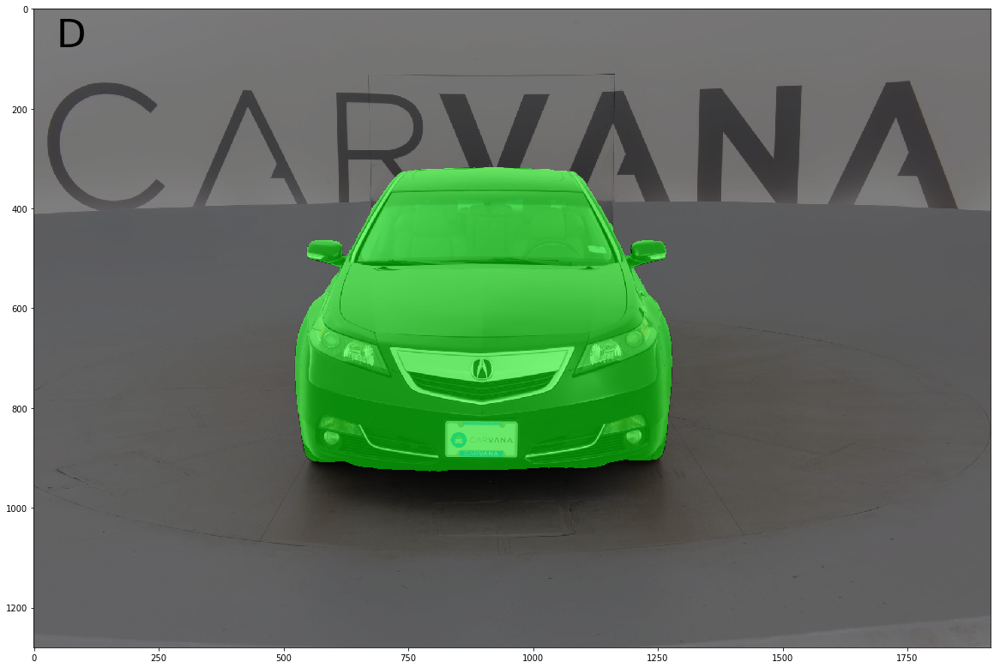

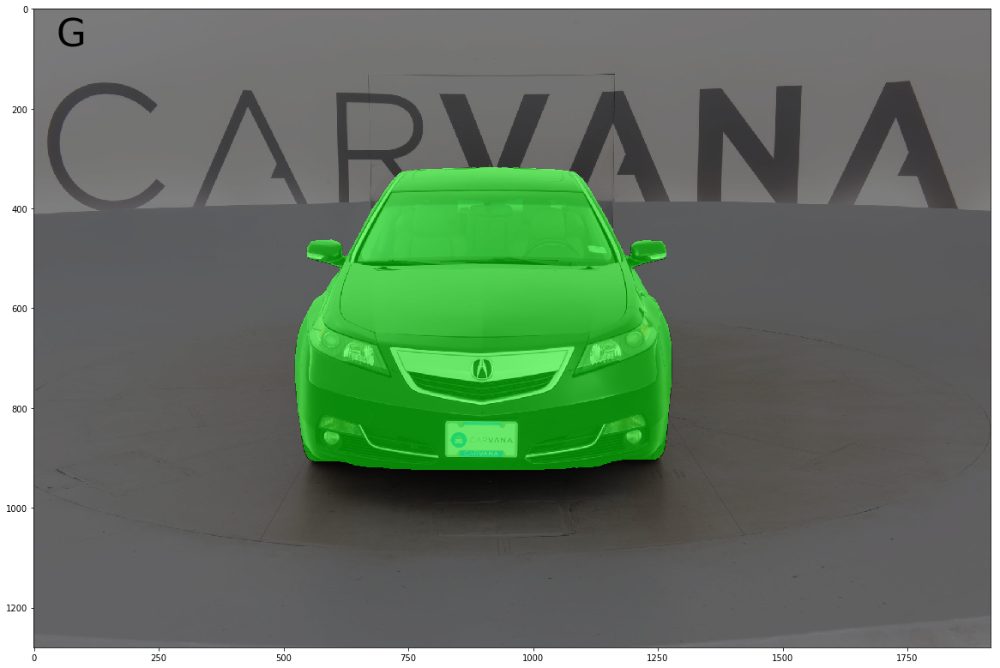

...

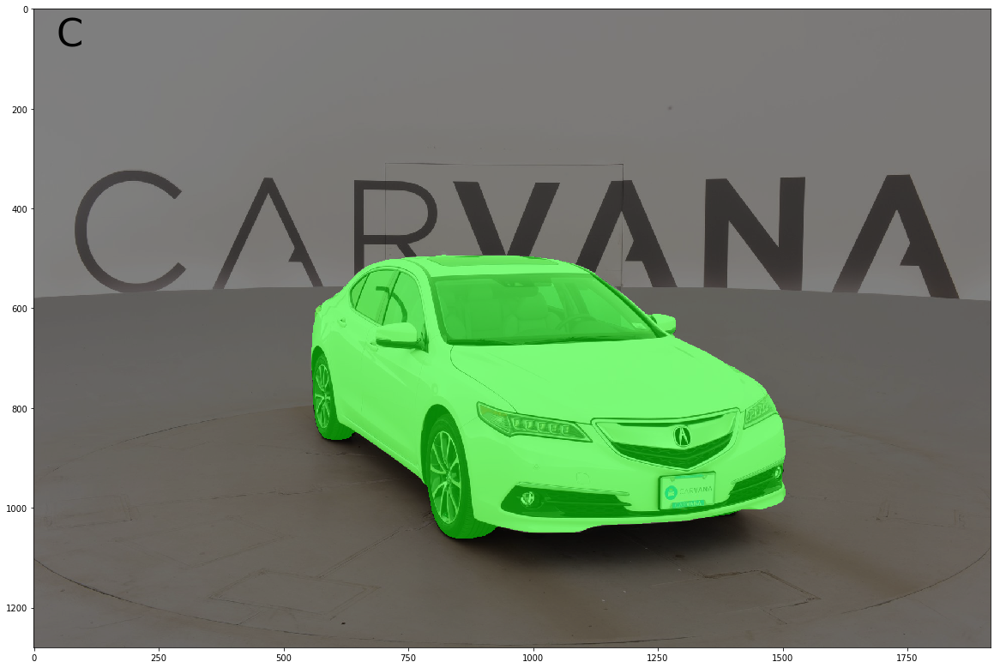

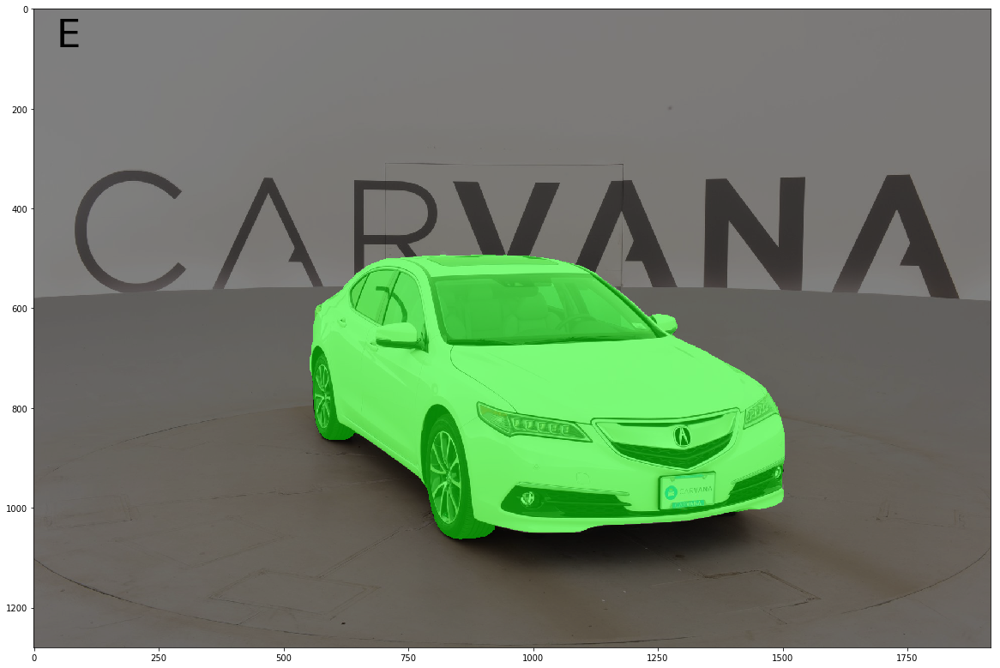

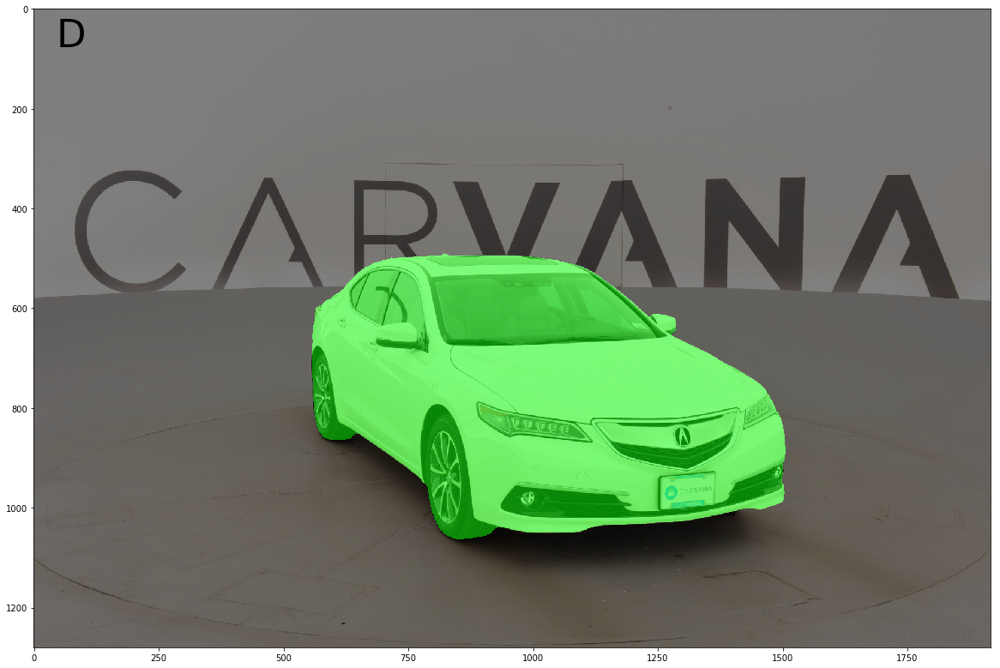

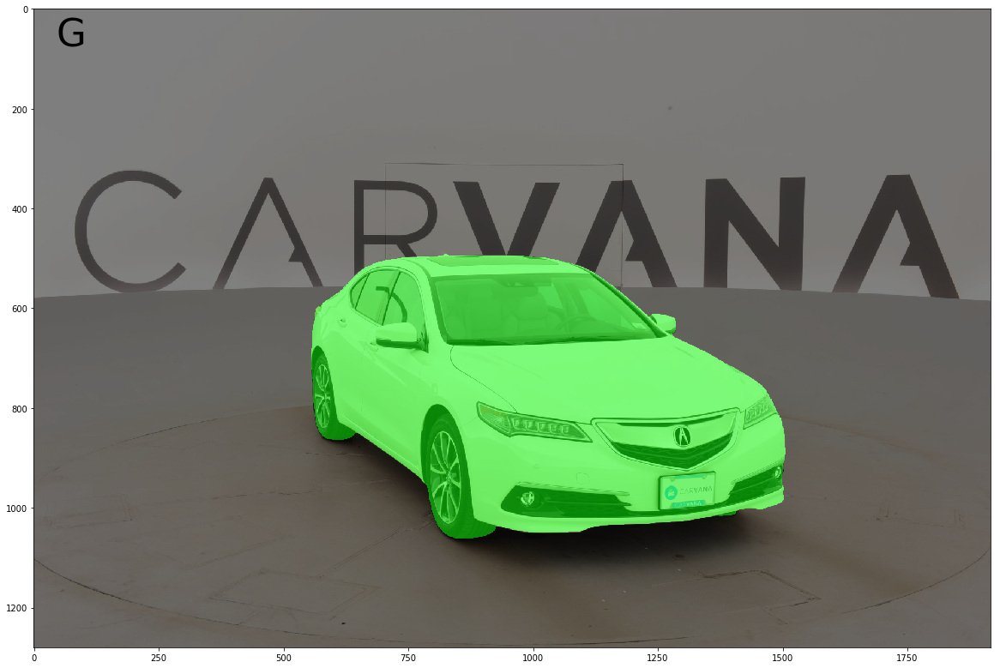

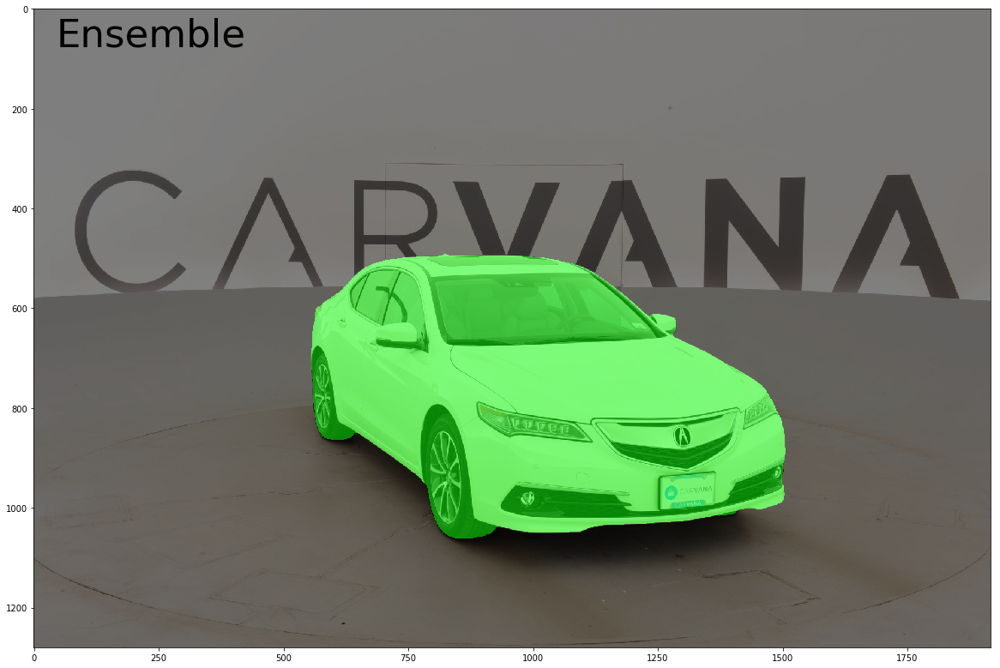

In [43]:
def run_length_decode(rle, orig_width, orig_height):
    runs = np.array(rle[0].split(' ')).astype(int)
    runs[1::2] = runs[1::2] + runs[:-1:2]
    inds = np.zeros(orig_height * orig_width)
    runs = runs - 1
    starts = runs[::2]
    ends = runs[1::2]
    for start, end in zip(starts, ends):
        inds[start:end] = 1
    mask = inds.reshape(orig_height, orig_width)
    return mask

def load_file(model, id):
    row = model[model.img == "{}.jpg".format(id)]
    rle = row.rle_mask.values
    prob = run_length_decode(rle, orig_width, orig_height)
    return np.expand_dims(prob, axis=2)

def display(model_name, model, id):
    mask = load_file(model, id)
    img = mpimg.imread('input/test_hq/{}.jpg'.format(id))
    
    mask3 = -mask.repeat(3, axis=2) * (0, 1, 0)
    mask3 = np.array(mask3, dtype='uint8')
    
    cv2.addWeighted(mask3, .5, img, .5, 0, img)
    plt.imshow(img)
    plt.text(45, 75, model_name, fontsize=45)
    plt.show()

for id in ids_test[:70:7]:
    for model_name, model in models.iteritems():
        display(model_name, model, id)